In [1]:
# conda base 

# Data manipulation 
import pandas as pd 
import numpy as np
from collections import Counter

# Data viz
import matplotlib.pyplot as plt 
from matplotlib import cm
import seaborn as sns
import plotly.express as px

In [2]:
# load seqs annots
df_annot = pd.read_csv("../results/tables/df_annot_all.csv", sep = "\t")

# load tsne coords and merge annots
df_sbl = pd.read_csv("../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_sbl_esm1b.csv")
df_sbl = df_sbl.merge(df_annot, on = "seq_id")

# select class a coords and filters anomalies 
df_a = df_sbl[df_sbl.bla_class == "Class A"]
df_a = df_a[df_a.tSNE1_esm1b.between(-60, 20)]
print(f"{len(df_a)}")

#filter by len 
df_a_filtered = df_a[df_a['length'].between(209.3, 388.7)]
print(f"{len(df_a_filtered)}")

13312
13203


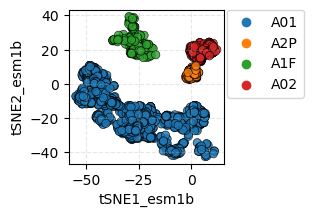

In [3]:
df_sub = df_a.copy()

conditions = [  
    (df_sub.tSNE1_esm1b.between(-40,-15) & df_sub.tSNE2_esm1b.between(10,50)),
    
    (df_sub.tSNE1_esm1b.between(-5,15) & df_sub.tSNE2_esm1b.between(12,26)),
    
    (df_sub.tSNE1_esm1b.between(-5,5) & df_sub.tSNE2_esm1b.between(0,11)),
]

values = ["A1F","A02","A2P"]

df_sub["sub_class"]  = np.select(conditions, values)
df_sub["sub_class"] = df_sub.sub_class.str.replace("0", "A01")
df_sub["sub_class"] = df_sub.sub_class.str.replace("AA012", "A02")

# plotly
# fig = px.scatter(df_sub[df_sub.is_clust90_rep.str.contains("Yes")],  opacity=0.2,
#                  x = "tSNE1_esm1b",y = "tSNE2_esm1b", height=600, width=650, color="sub_class") 
# fig.update_traces(marker=dict(size=9, line=dict(width=1,color="black")),selector=dict(mode='markers'))
# fig.update_layout(template="plotly_white")
# #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
# #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
# fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
# fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')

plt.figure(figsize=(2,2))
sns.scatterplot(data = df_sub[df_sub.is_clust90_rep.str.contains("Yes")], 
                x = "tSNE1_esm1b",y = "tSNE2_esm1b", hue = "sub_class", 
                edgecolor = "black" , alpha = 0.8, )
plt.legend(ncol=1, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.grid(alpha=0.3, linestyle="--")

In [4]:
df_sub[df_sub.is_clust90_rep.str.contains("Yes")]

,tSNE1_esm1b,tSNE2_esm1b,seq_id,#name,seq,length,filename,protein_name,protein_family,bla_class,...,predicted_signal_peptide,Other_sigpept,SP(Sec/SPI),LIPO(Sec/SPII),TAT(Tat/SPI),TATLIPO(Sec/SPII),PILIN(Sec/SPIII),CS Position,seq_without_sigpept,sub_class
3,-0.283795,-13.681005,seq_0,gi|5596421|emb|CAB51471.1|ACI-1| class A exten...,MKKFCFLFLIICGLMVFCLQDCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-1-prot.fasta,ACI-1,ACI,Class A,...,LIPO,0.000157,0.499448,0.500170,0.000095,0.000088,0.000081,CS pos: 21-22. Pr: 0.4839,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,A01
10,-5.973212,-24.374222,seq_7,gi|2992469|gb|AAC09015.1|AER-1| carbenicillin-...,MYVLSVEKPTLRNKFAAGIGVVLVCVVASFIPTPVFALDTTKLIQA...,304,A-AER-1-prot.fasta,AER-1,AER,Class A,...,SP,0.000623,0.998624,0.000208,0.000219,0.000171,0.000160,CS pos: 37-38. Pr: 0.9657,LDTTKLIQAVQSEESALHARVGMTVFDSNTGTTWNYRGDERFPLNS...,A01
12,4.304225,-17.702717,seq_9,gi|40950501|gb|AAR97884.1|AFA-1| class A beta-...,MKIKPFLFGLIVLANNAIAGSLTQNIEAIELSSGGYIGVSVLNTET...,283,A-AFA-1-prot.fasta,AFA-1,AFA,Class A,...,SP,0.000344,0.998690,0.000311,0.000252,0.000213,0.000201,CS pos: 19-20. Pr: 0.9754,GSLTQNIEAIELSSGGYIGVSVLNTETNKTWEYKGDQRFPMMSTFK...,A01
30,-1.333390,4.079786,seq_27,CUS46161.1|AFAM0002-1| Beta-lactamase [hydroth...,MTLLAAALCACGHDTSRHLTLIPAAAVRPPYQVVVPVPPPTPRPVP...,367,A-AFAM0002-1-prot.fasta,AFAM0002-1,AFAM0002,Class A,...,LIPO,0.000070,0.119053,0.880740,0.000047,0.000042,0.000049,CS pos: 10-11. Pr: 0.8713,CGHDTSRHLTLIPAAAVRPPYQVVVPVPPPTPRPVPPRAPEALVAN...,A2P
31,-27.462710,-24.082703,seq_28,EQD65118.1|AFAM0003-1| CTX-M-1-derivative beta...,MGMLSRRQVLKGMALGVAAGALRTVPVRAASLASALHAQFARIESQ...,301,A-AFAM0003-1-prot.fasta,AFAM0003-1,AFAM0003,Class A,...,TAT,0.000000,0.000000,0.000000,0.999999,0.000000,0.000000,CS pos: 29-30. Pr: 0.9348,ASLASALHAQFARIESQTGGRLGVAMLDTHNRIAAGYRANQRFPVC...,A01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13295,-19.016348,-31.276167,seq_13292,CNI84083.1|YENT-C-1| class A beta-lactamase,MKHSPLRRSLLLAGITLPLTHFALPAWATPPESLDKQLAELERKSN...,293,A-YENT-C-1-prot.fasta,YENT-C-1,YENT,Class A,...,TAT,0.000043,0.166529,0.000035,0.833343,0.000051,0.000017,CS pos: 28-29. Pr: 0.7248,TPPESLDKQLAELERKSNGLLGIAMINTANGRKIQYRGTQRFPFCS...,A01
13298,-18.779877,-31.421637,seq_13295,CNK44081.1|YENT-D-1| class A beta-lactamase,MKHSPLRRSLLLAGITLPLVNFSLPAWAAAPSDLLGNQLAELERKS...,298,A-YENT-D-1-prot.fasta,YENT-D-1,YENT,Class A,...,TAT,0.000024,0.166561,0.000025,0.833361,0.000017,0.000015,CS pos: 28-29. Pr: 0.7526,AAPSDLLGNQLAELERKSNGRLGVTMINTANGRKIQYRGTQRFPFC...,A01
13310,-19.346890,-31.425873,seq_13307,CNB72437.1|YENT-E-6| beta-lactamase [Yersinia ...,MKHSPLRRSLLLAGITVPLLNFALPSWAVGAKLSLDNQLAELEKSS...,305,A-YENT-E-6-prot.fasta,YENT-E-6,YENT,Class A,...,TAT,0.000030,0.166550,0.000029,0.833373,0.000019,0.000017,CS pos: 28-29. Pr: 0.7504,VGAKLSLDNQLAELEKSSNGRLGLALINTGKGTKIHYRGGQRFPFC...,A01
13314,-19.150366,-31.406748,seq_13311,CNH11254.1|YENT-F-1| class A beta-lactamase,MKHSPLRRSLLLAGISVPLVSFVLPAWAAAIPASLDNQLAELEQTS...,294,A-YENT-F-1-prot.fasta,YENT-F-1,YENT,Class A,...,TAT,0.000025,0.166564,0.000024,0.833378,0.000016,0.000014,CS pos: 28-29. Pr: 0.7622,AAIPASLDNQLAELEQTSNGRLGIALINTANGKKVQYRGGQRFPFC...,A01


[Text(0, 0, '8986'), Text(0, 0, '626'), Text(0, 0, '2344'), Text(0, 0, '1356')]

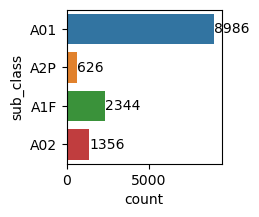

In [5]:
plt.figure(figsize=(2,2))
ax = sns.countplot(data = df_sub, y = "sub_class")
ax.bar_label(ax.containers[0])

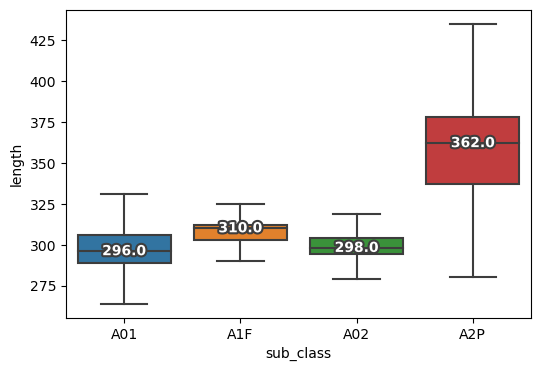

In [6]:
import matplotlib.patheffects as path_effects
# https://stackoverflow.com/questions/38649501/labeling-boxplot-in-seaborn-with-median-value 

def add_median_labels(ax, fmt='.1f'):
    lines = ax.get_lines()
    boxes = [c for c in ax.get_children() if type(c).__name__ == 'PathPatch']
    lines_per_box = int(len(lines) / len(boxes))
    for median in lines[4:len(lines):lines_per_box]:
        x, y = (data.mean() for data in median.get_data())
        # choose value depending on horizontal or vertical plot orientation
        value = x if (median.get_xdata()[1] - median.get_xdata()[0]) == 0 else y
        text = ax.text(x, y, f'{value:{fmt}}', ha='center', va='center',
                       fontweight='bold', color='white')
        # create median-colored border around white text for contrast
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground=median.get_color()),
            path_effects.Normal(),
        ])

plt.figure(figsize=(6,4))
ax = sns.boxplot(data=df_sub, x="sub_class", y="length",showfliers=False,order=["A01","A1F","A02","A2P"])
add_median_labels(ax)
plt.show()

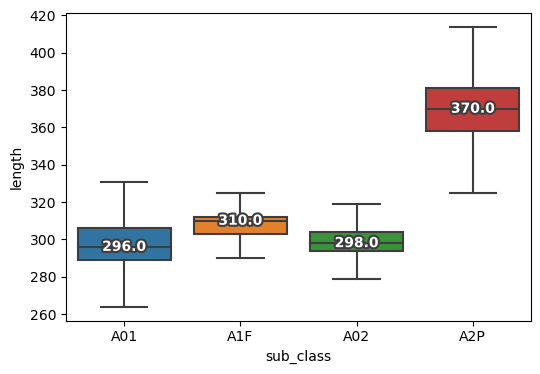

In [7]:
df_sphingo = df_sub.copy()
df_sphingo = df_sphingo[~df_sphingo.sub_class.str.contains("A2P")]

sphingo = df_sub[(df_sub.sub_class.str.contains("A2P")) & (df_sub.Family.str.contains("Sphingomonadaceae"))]

df_sphingo = pd.concat([df_sphingo, sphingo])

plt.figure(figsize=(6,4))
ax = sns.boxplot(data=df_sphingo, x="sub_class", y="length",showfliers=False,order=["A01","A1F","A02","A2P"])
add_median_labels(ax)
plt.show()

In [8]:
print(f"sphingo seqs = {len(sphingo)}")

sphingo seqs = 429


In [9]:
# print(f"sphingo seqs = {len(sphingo)}")
# 
# texto = sphingo['#name'].values  # Extraer el contenido de la columna como un arreglo de Numpy
# 
# with open('sphingo_headers.txt', 'w') as file:
#     for linea in texto:
#         file.write(str(linea) + '\n') 
#         
# ! mv sphingo_headers.txt /home/gama/desktop/

# or 
# sphingo["#name"].to_csv("/home/gama/desktop/sphingo_headers.txt", index=False, header=False)

In [10]:
df_sub.groupby('sub_class')['length'].describe()

,count,mean,std,min,25%,50%,75%,max
sub_class,,,,,,,,
A01,8986.0,297.505008,19.460824,95.0,289.0,296.0,306.0,609.0
A02,1356.0,303.147493,32.294294,209.0,294.0,298.0,304.0,674.0
A1F,2344.0,305.663823,16.645959,209.0,303.0,310.0,312.0,595.0
A2P,626.0,358.533546,29.174065,268.0,337.0,362.0,378.0,503.0


In [11]:
df_sub.groupby(['sub_class'])['length'].median()

sub_class
A01    296.0
A02    298.0
A1F    310.0
A2P    362.0
Name: length, dtype: float64

In [12]:
medians = df_sub.groupby(['sub_class'])['length'].median().values
print(f"medians = {medians}")

medians_range = medians*0.3
print(f"medians 30% = {medians_range}\n")

print(f"upper limit = {medians+medians_range}")
print(f"lower limit = {medians-+medians_range}")

medians = [296. 298. 310. 362.]
medians 30% = [ 88.8  89.4  93.  108.6]

upper limit = [384.8 387.4 403.  470.6]
lower limit = [207.2 208.6 217.  253.4]


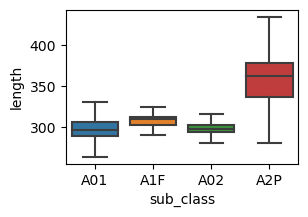

In [13]:
med_a01 = df_sub[(df_sub.sub_class == "A01") & (df_sub.length.between(207.2, 384.8))]
med_a02 = df_sub[(df_sub.sub_class == "A02") & (df_sub.length.between(208.6, 387.4))]
med_a1f = df_sub[(df_sub.sub_class == "A1F") & (df_sub.length.between(217  , 403.8))]
med_a2p = df_sub[(df_sub.sub_class == "A2P") & (df_sub.length.between(253.4, 470.6))]

plt.figure(figsize=(3,2))
df_sub_filt_median = pd.concat([med_a01,med_a1f,med_a02,med_a2p])
sns.boxplot(data=df_sub_filt_median, x="sub_class", y="length",showfliers=False,
           order = ["A01","A1F","A02","A2P"]);

In [14]:
df_sub_filt_median.groupby('sub_class')['length'].describe()

,count,mean,std,min,25%,50%,75%,max
sub_class,,,,,,,,
A01,8955.0,297.160022,15.667829,208.0,289.0,296.0,306.0,383.0
A02,1339.0,300.142644,14.552512,209.0,294.0,298.0,303.0,386.0
A1F,2336.0,305.636130,14.564230,238.0,303.0,310.0,312.0,349.0
A2P,625.0,358.302400,28.618004,268.0,337.0,362.0,378.0,466.0


<AxesSubplot:xlabel='sub_class', ylabel='length'>

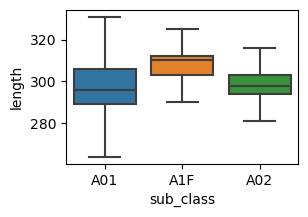

In [15]:
plt.figure(figsize=(3,2))
sns.boxplot(data=df_sub_filt_median[~df_sub_filt_median.sub_class.str.contains("A2P")], 
            x="sub_class", y="length",showfliers=False,
           order = ["A01","A1F","A02"])

data points = 4061


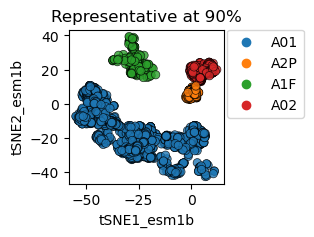

In [16]:
df_sub_a90 = df_sub[df_sub.is_clust90_rep =="Yes"]

plt.figure(figsize=(2,2))
sns.scatterplot(data = df_sub_a90, x = "tSNE1_esm1b",y = "tSNE2_esm1b", hue = "sub_class", 
                edgecolor = "black" , alpha = 0.8)
plt.legend(ncol=1, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("Representative at 90%")
print(f"data points = {len(df_sub_a90)}")

[Text(0, 0, '2916'), Text(0, 0, '306'), Text(0, 0, '251'), Text(0, 0, '588')]

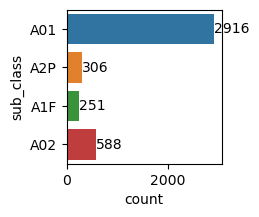

In [17]:
plt.figure(figsize=(2,2))
ax = sns.countplot(data = df_sub_a90, y = "sub_class")
ax.bar_label(ax.containers[0])

<AxesSubplot:xlabel='sub_class', ylabel='length'>

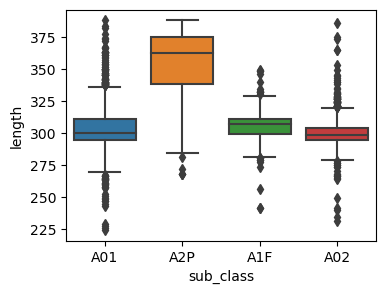

In [18]:
plt.figure(figsize=(4,3))
sns.boxplot(data=df_sub_a90, x="sub_class", y="length")

In [19]:
df_sub_a90.groupby('sub_class')['length'].describe()

,count,mean,std,min,25%,50%,75%,max
sub_class,,,,,,,,
A01,2916.0,302.957133,15.109544,224.0,294.0,300.0,311.0,388.0
A02,588.0,300.967687,14.712832,231.0,294.0,298.5,304.0,386.0
A1F,251.0,304.868526,13.813712,241.0,299.0,307.0,311.0,349.0
A2P,306.0,355.754902,24.208020,268.0,338.0,362.0,375.0,388.0


In [20]:
a1f = df_sub_a90[df_sub_a90.sub_class == "A1F"]
print(f"a1f = {len(a1f)}")

a01 = df_sub_a90[df_sub_a90.sub_class == "A01"]
print(f"a01 = {len(a01)}")

a02 = df_sub_a90[df_sub_a90.sub_class == "A02"]
print(f"a02 = {len(a02)}")

a2p = df_sub_a90[df_sub_a90.sub_class == "A2P"]
print(f"a2p = {len(a2p)}")

a1f = 251
a01 = 2916
a02 = 588
a2p = 306


In [21]:
# a1f[["seq_id", "seq"]].to_csv("/home/gama/desktop/class_a_rand_20/msa/a1f_clust90.csv", index = False, sep = "\t", header = False)
# a01[["seq_id", "seq"]].to_csv("/home/gama/desktop/class_a_rand_20/msa/a01_clust90.csv", index = False, sep = "\t", header = False)
# a02[["seq_id", "seq"]].to_csv("/home/gama/desktop/class_a_rand_20/msa/a02_clust90.csv", index = False, sep = "\t", header = False)
# a2p[["seq_id", "seq"]].to_csv("/home/gama/desktop/class_a_rand_20/msa/a2p_clust90.csv", index = False, sep = "\t", header = False)

In [22]:
rand_a1f = a1f.sample(20)
rand_a01 = a01.sample(20)
rand_a02 = a02.sample(20)
rand_a2p = a2p.sample(20)

In [23]:
rand_20 = pd.concat([rand_a1f,rand_a01,rand_a02,rand_a2p])

rand_20["protein_tag"] = rand_20["sub_class"] + "_" + rand_20["protein_name"]
rand_20["protein_tag"] = rand_20["protein_tag"].str.replace("-", "_")
rand_20.head(2)

,tSNE1_esm1b,tSNE2_esm1b,seq_id,#name,seq,length,filename,protein_name,protein_family,bla_class,...,Other_sigpept,SP(Sec/SPI),LIPO(Sec/SPII),TAT(Tat/SPI),TATLIPO(Sec/SPII),PILIN(Sec/SPIII),CS Position,seq_without_sigpept,sub_class,protein_tag
2896,-29.705658,24.733803,seq_2893,WP_082386230.1|AFAM2835-2| class A beta-lactamase,MRGLVVLKSVSVLKIWMSVGLLSLSLFGDGLKQTEAKENVDQTQRT...,307,A-AFAM2835-2-prot.fasta,AFAM2835-2,AFAM2835,Class A,...,0.000184,0.697033,0.302433,0.000148,0.000114,0.000111,CS pos: 36-37. Pr: 0.6541,KENVDQTQRTSHRTVNKFMQLEKKFDARLGIYAIDTGTNRTVVYRP...,A1F,A1F_AFAM2835_2
9447,-21.164740,22.898550,seq_9444,BAH07623.1|CKA-1| class A beta-lactamase,MQKIVNLKLKANKLKFGVLMMLVIFFLTSCGKTESQSHLNTKSDIQ...,310,A-CKA-1-prot.fasta,CKA-1,CKA,Class A,...,0.000004,0.000026,0.999977,0.000000,0.000000,0.000000,CS pos: 29-30. Pr: 0.9973,CGKTESQSHLNTKSDIQYNSAFSQLESDYGAKLGVYAFDTETNKEV...,A1F,A1F_CKA_1


In [24]:
#rand_20.to_pickle("/home/gama/desktop/class_a_rand_20/rand_20.pkl")
#rand_20[["protein_tag", "seq_without_sigpept"]].to_csv("/home/gama/desktop/class_a_rand_20/rand_20_to_fold.csv", index = False)

In [25]:
# export seqs to do msa and logos 
# a1[["seq_id", "seq"]].to_csv("/home/gama/desktop/a1_clust90.csv", index = False, sep = "\t", header = False)
# a2[["seq_id", "seq"]].to_csv("/home/gama/desktop/a2_clust90.csv", index = False, sep = "\t", header = False)
# a3[["seq_id", "seq"]].to_csv("/home/gama/desktop/a3_clust90.csv", index = False, sep = "\t", header = False)

In [26]:
# DEFINICIONES DEL PAPER DE PHILIPPON DEL 2019 

# No estan: SPU
# Cbl en el paper esta como CblA en la BLDB
cluster_a = [
    "PER","VEB","CSP","SPU","CME","CIA","CGA","TLA","TLA2","LUS","CfxA",
    "CepA", "CblA"
]

# estan todas
cluster_b = [
    "PME","SGM","GES","BEL"
]

# no estan: VHH VHW AmpC MP RHOCA RTG SEL PSE
# cambie OKP por OKP-A/B que no estan en la bldb
cluster_c = [
    "VHH","VHW","AmpC", "MP","RHOCA","LAP","SHV","OHIO","LEN",
    "OKP","TER","GIL","TEM", "RUB","RTG","SCO","SEL",
    "HER","PSE","AER", "CKO","MAL","PLES","CARB","PAL","HMS",
    "ORN", "KLUY", "FPH"
]

# no estan: BlaAZ BlaIII BlaY BlaF STRCE STRCL STRFR STRLA STRAL FAR STRCAO STRCA
cluster_d = [
    "CAD","BlaAZ", "ARL","ROB", "ACI","CBP","BCL","BlaIII","BlaP",
    "OIH","BlaY","BlaS","BlaF","STRCE", "STRCL","STRFR","STRLA",
    "STRAL","MAB","FAR","AST", "BlaC", "STRCAO","STRCA","R39"
]

# no estan: VCC CRS YENT K1
cluster_e = [
    "FRI","VCC","IMI","NMCA","SME","SFC","BIC","CRS","CRH","CRP","KPC",
    "PenB","PenA","LUT","PenL","BPS","PenI","MIN","DES","BES","ERP",
    "YENT","HugA","CumA","SMO","RAHN","FONA","SFO","KLUC",
    "CTX-M","KLUA","KLUG","SED","RIC","GRI","K1","OXY"
]

# todas si estan en la BLDB
cluster_f = [
    "XCC","BOR","AXC","PAD","BKC","GPC", "CzoA", "L2"
]

#cluster_no = [
#    'BcI', 'BRO', 'BBI', 'ASU1', 'BcIII', 'RPA', 'RSA1', 'RSA2', 
#    'SDA', 'FTU', 'GPA', 'RCP', 'FLC', 'FEC', 'DBA', 'PenP', 
#    'RAA', 'CST', 'CPA', 'CM1', 'CKA', 'VBR', 'CdiA', 'PC1', 
#    'PC2', 'PbbA', 'PSV', 'PLA', 'MIA', 'MM3', 'PAU', 'ORF6', 
#    'PenE', 'BlaA', 'AFA']

#cluster_x = [
#     "BRO","FTU", "FPH"
#]


filters = [
    df_a.protein_family_header.str.contains("|".join(cluster_a)),
    df_a.protein_family_header.str.contains("|".join(cluster_b)),
    df_a.protein_family_header.str.contains("|".join(cluster_c)),
    df_a.protein_family_header.str.contains("|".join(cluster_d)),
    df_a.protein_family_header.str.contains("|".join(cluster_e)),
    df_a.protein_family_header.str.contains("|".join(cluster_f)),
    # df_a.protein_family_header.str.contains("|".join(cluster_x)),
]

values = ["A","B", "C", "D", "E", "F", 
          #"x"
]

#    "Group C (LSBL; limited-spectrum beta-lactamases)",
#    "Group D (Gram positive)",
#    "Group E (WSBL; wider spectrum betalactamases)",
#    "Group F (Gram negative rods)",
#    "Group A (Subclass A2)"
   
df_a["Group"] = np.select(filters, values)

df_a["Group"] = df_a.Group.str.replace("0","Unknown")
df_a = df_a.sort_values("Group")

In [27]:
for ele in df_a.Group.unique():
    print(f"##### {ele} #####")
    print(f"number of families: {df_a[df_a.Group == ele].protein_family_header.nunique()}")
    print(df_a[df_a.Group == ele].protein_family_header.unique())
    print("\n")

##### A #####
number of families: 11
['CME' 'PER' 'VEB' 'CfxA' 'CIA' 'TLA' 'TLA2' 'CGA' 'LUS' 'CblA' 'CepA']


##### B #####
number of families: 4
['SGM' 'BEL' 'PME' 'GES']


##### C #####
number of families: 21
['LAP' 'KLUY' 'LEN' 'TEM' 'HMS' 'GIL' 'TER' 'SHV' 'CARB' 'PAL' 'ORN' 'OKP'
 'CKO' 'FPH' 'PLES' 'AER' 'OHIO' 'MP' 'MAL' 'RUB' 'SCO']


##### D #####
number of families: 12
['MAB' 'FAR' 'BlaS' 'CBP' 'OIH' 'CAD' 'ACI' 'ARL' 'ROB' 'AST' 'BCL' 'R39']


##### E #####
number of families: 27
['CTX-M' 'RIC' 'RAHN' 'PenB' 'DES' 'LUT' 'KPC' 'MIN' 'ERP' 'FONA' 'KLUA'
 'IMI' 'BES' 'BIC' 'KLUG' 'KLUC' 'BPS' 'FRI' 'HugA' 'SED' 'SFC' 'SME'
 'SFO' 'CRP' 'CRH' 'PenA' 'OXY']


##### F #####
number of families: 8
['XCC' 'BKC' 'CzoA' 'BOR' 'GPC' 'L2' 'AXC' 'PAD']


##### Unknown #####
number of families: 36
['Other' 'ASU1' 'BcI' 'BBI' 'BRO' 'CdiA' 'PenE' 'PC2' 'PC1' 'PbbA' 'PSV'
 'PLA' 'MM3' 'MIA' 'ORF6' 'PAU' 'SDA' 'RSA2' 'RSA1' 'RPA' 'RCP' 'RAA'
 'PenP' 'VBR' 'BcIII' 'BlaA' 'CM1' 'CST' 'CPA' 'DBA

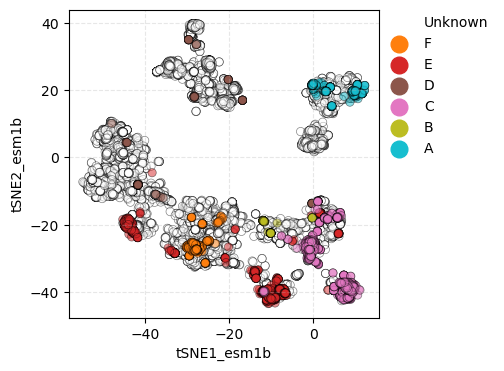

In [28]:
# create a custom palette 
cmap = cm.get_cmap('tab10', df_a.Group.nunique())   
custom_palette = []
for i in range(cmap.N):
    rgba = cmap(i)
    # rgb2hex accepts rgb or rgba
    custom_palette.append(cm.colors.rgb2hex(rgba))
custom_palette[0] = "#ffffff"
custom_palette= sns.color_palette(custom_palette)

# plot
plt.figure(figsize=(4,4))
sns.scatterplot(data = df_a.sort_values("Group", ascending = False), x = "tSNE1_esm1b",y = "tSNE2_esm1b", 
                palette = custom_palette,
                hue = "Group", edgecolor = "black", alpha = 0.5)

handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles, labels, bbox_to_anchor=(0.98, 1.02), loc='upper left', fontsize=10, markerscale=2, frameon = False, 
           edgecolor = "black")
plt.grid(alpha=0.3, linestyle="--");

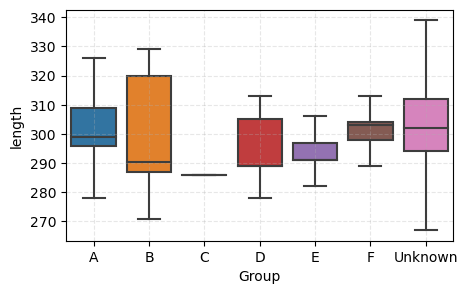

In [29]:
plt.figure(figsize=(5,3))
sns.boxplot(data=df_a, x="Group", y="length",showfliers=False)
plt.grid(alpha=0.3, linestyle="--")

In [30]:
def do_iscatter(df, annot):
    
    """
    do a scatterplot given a df and hue
    """
    
    my_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
    my_colors[0] = "#FFFFFF"

    
    # plot
    fig = px.scatter(
    df, x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 550, color = annot, 
    hover_name = annot, opacity=1, color_discrete_sequence = my_colors,
    hover_data = ["protein_family_header", '#name'])

    fig.update_traces(marker=dict(size=10, line=dict(width=2,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
    white_marker_style = {'marker': {'opacity': 0.005}}
    for i, color in enumerate(my_colors):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    # fig.update_layout(plot_bgcolor='black')
    
    fig.show() 
    
do_iscatter(df_a.sort_values("Group", ascending=False), "Group")

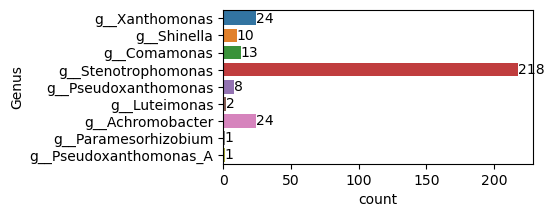

In [31]:
plt.figure(figsize=(4,2))
ax = sns.countplot(data = df_a[df_a.Group == "F"], y = "Genus")
ax.bar_label(ax.containers[0]);

In [32]:
df_a_fams = df_a.copy()

top18fam_a = list(df_a_fams["protein_family_header"].value_counts()[:19].index)
df_a_fams.loc[~df_a_fams["protein_family_header"].isin(top18fam_a), "protein_family_header"] = 'No in top 20'

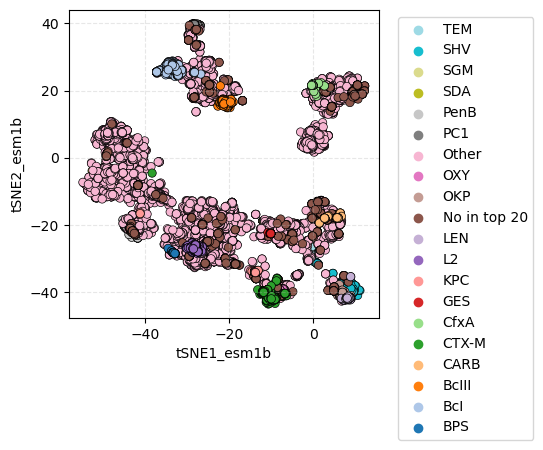

In [33]:
def do_iscatter_enz(df, annot):
    
    """
    do a scatterplot given a df and hue
    """

    
    # plot
    fig = px.scatter(
    df, x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence =  px.colors.qualitative.Dark24,
    hover_data = ["protein_family_header", '#name'])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.show() 
    
    
# do_iscatter_enz(df_a_fams, "protein_family_header")
plt.figure(figsize=(4,4))
sns.scatterplot(data=df_a_fams.sort_values("protein_family_header", ascending=False), palette="tab20_r",
                x='tSNE1_esm1b',y='tSNE2_esm1b',hue="protein_family_header", edgecolor="k")
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.grid(alpha=0.3, linestyle="--")

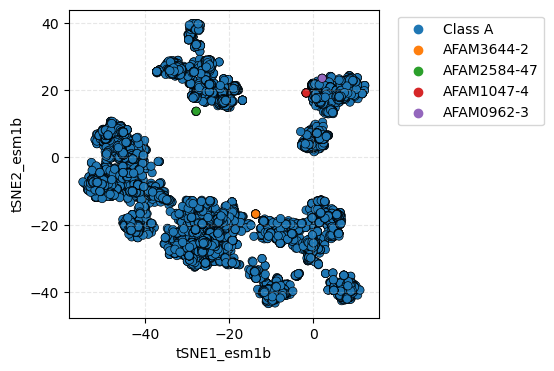

In [34]:
df_a_fams.loc[df_a_fams.protein_name == "AFAM2584-47", "bla_class"] = 'AFAM2584-47'
df_a_fams.loc[df_a_fams.protein_name == "AFAM1047-4", "bla_class"] = 'AFAM1047-4'
df_a_fams.loc[df_a_fams.protein_name == "AFAM3644-2", "bla_class"] = 'AFAM3644-2'
df_a_fams.loc[df_a_fams.protein_name == "AFAM0962-3", "bla_class"] = 'AFAM0962-3'

# do_iscatter_enz(df_a_fams.sort_values("bla_class", ascending=False), "bla_class")
plt.figure(figsize=(4,4))
sns.scatterplot(data=df_a_fams.sort_values("bla_class", ascending=False), 
                x='tSNE1_esm1b',y='tSNE2_esm1b',hue="bla_class", edgecolor="k")
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.grid(alpha=0.3, linestyle="--")

In [35]:
df_a_fams_tems = df_a.copy()
df_a_fams_tems = df_a_fams_tems[
    (df_a_fams_tems.tSNE1_esm1b.between(-21, 15)) & (df_a_fams_tems.tSNE2_esm1b.between(-50, -10))]

top22fam_a = list(df_a_fams_tems["protein_family_header"].value_counts()[:25].index)
df_a_fams_tems.loc[~df_a_fams_tems["protein_family_header"].isin(top22fam_a), "protein_family_header"] = 'No in top 25'

df_a_fams_tems.loc[df_a_fams_tems.protein_name == "SHV-P3", "protein_family_header"] = 'SHV-P3'

def do_iscatter_enz2(df, annot):
    
    """
    do a scatterplot given a df and hue
    """

    
    # plot
    fig = px.scatter(
    df[~df.protein_family_header.str.contains("Other")], 
    x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence =  px.colors.qualitative.Alphabet,
    hover_data = ["protein_family_header", '#name',  "length"])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.show() 
    
do_iscatter_enz2(df_a_fams_tems, "protein_family_header")

In [36]:
def do_iscatter2(df,x,y, annot):
    
    """
    do a scatterplot given a df and hue
    """
    my_colors = px.colors.qualitative.G10
    my_colors[6] = "#FFFFFF"

    
    # plot
    fig = px.scatter(
    df, x = x, y = y,
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence = my_colors,
    hover_data = ["protein_family_header", '#name'])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
    white_marker_style = {'marker': {'opacity': 0.02}}
    for i, color in enumerate(my_colors):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    # fig.update_layout(plot_bgcolor='black')
    
    fig.show()  
    
do_iscatter2(df_a, 'tSNE1_esm1b', 'tSNE2_esm1b',"Group")

13203


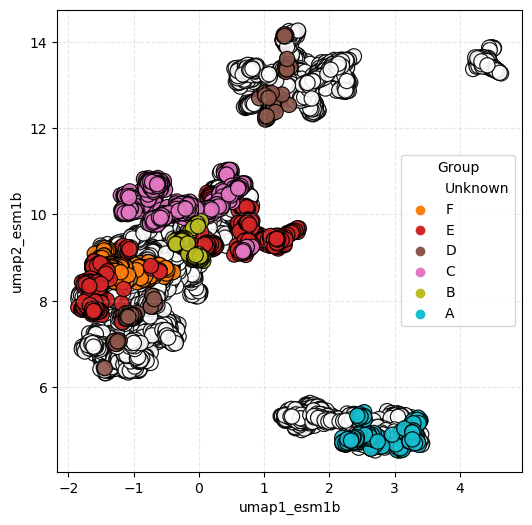

In [37]:
#load uma coords
df_umap = pd.read_csv("../results/dim_redo/splitted_classes/umap/umap_2d_plm_sbl_esm1b.csv")
df_umap = df_umap.merge(df_annot, on = "seq_id")
df_umap = df_umap[df_umap.bla_class.str.contains("Class A")]

#filter by len 
df_umap = df_umap[df_umap['length'].between(209.3, 388.7)]
print(f"{len(df_umap)}")


filters = [
    df_umap.protein_family_header.str.contains("|".join(cluster_a)),
    df_umap.protein_family_header.str.contains("|".join(cluster_b)),
    df_umap.protein_family_header.str.contains("|".join(cluster_c)),
    df_umap.protein_family_header.str.contains("|".join(cluster_d)),
    df_umap.protein_family_header.str.contains("|".join(cluster_e)),
    df_umap.protein_family_header.str.contains("|".join(cluster_f)),
]

values = ["A","B", "C", "D", "E", "F"]

#    "Group C (LSBL; limited-spectrum beta-lactamases)",
#    "Group D (Gram positive)",
#    "Group E (WSBL; wider spectrum betalactamases)",
#    "Group F (Gram negative rods)",
#    "Group A (Subclass A2)"
   
df_umap["Group"] = np.select(filters, values)

df_umap["Group"] = df_umap.Group.str.replace("0","Unknown")
df_umap = df_umap.sort_values("Group")

# do_iscatter2(df_umap, "umap1_esm1b", "umap2_esm1b", "Group")

# plot
plt.figure(figsize=(6,6))
sns.scatterplot(data = df_umap.sort_values("Group", ascending = False), x = "umap1_esm1b",y = "umap2_esm1b", 
                palette = custom_palette, s=120,
                hue = "Group", edgecolor = "black", alpha = 0.9)
plt.grid(alpha=0.3, linestyle="--")
#handles, labels = plt.gca().get_legend_handles_labels()
#plt.legend(handles, labels, bbox_to_anchor=(0.98, 1.02), loc='upper left', fontsize=10, markerscale=2, frameon = False, edgecolor = None)

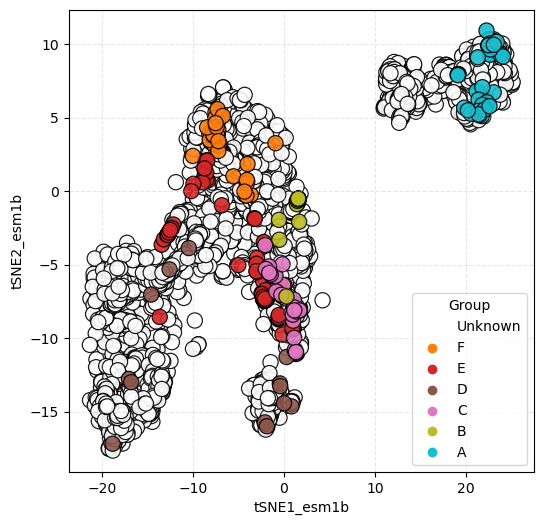

In [38]:
# load and merge representative dsets
df_sbl90 = pd.read_csv("../results/dim_redo/splitted_classes/tsne/tsne_2d_clust90_sbl_esm1b.csv")
df_sbl90 = df_sbl90.merge(df_annot, on = "seq_id")
df_sbl90 = df_sbl90[df_sbl90.bla_class == "Class A"]


filters = [
    df_sbl90.protein_family_header.str.contains("|".join(cluster_a)),
    df_sbl90.protein_family_header.str.contains("|".join(cluster_b)),
    df_sbl90.protein_family_header.str.contains("|".join(cluster_c)),
    df_sbl90.protein_family_header.str.contains("|".join(cluster_d)),
    df_sbl90.protein_family_header.str.contains("|".join(cluster_e)),
    df_sbl90.protein_family_header.str.contains("|".join(cluster_f)),
]

values = ["A","B", "C", "D", "E", "F"]

#    "Group C (LSBL; limited-spectrum beta-lactamases)",
#    "Group D (Gram positive)",
#    "Group E (WSBL; wider spectrum betalactamases)",
#    "Group F (Gram negative rods)",
#    "Group A (Subclass A2)"
   
df_sbl90["Group"] = np.select(filters, values)

df_sbl90["Group"] = df_sbl90.Group.str.replace("0","Unknown")
df_sbl90 = df_sbl90.sort_values("Group")

# do_iscatter(df_sbl90, "Group")
plt.figure(figsize=(6,6))
sns.scatterplot(data = df_sbl90.sort_values("Group", ascending = False), x = "tSNE1_esm1b",y = "tSNE2_esm1b", 
                palette = custom_palette, s=120, hue = "Group", edgecolor = "black", alpha = 0.9)
plt.grid(alpha=0.3, linestyle="--")

13203


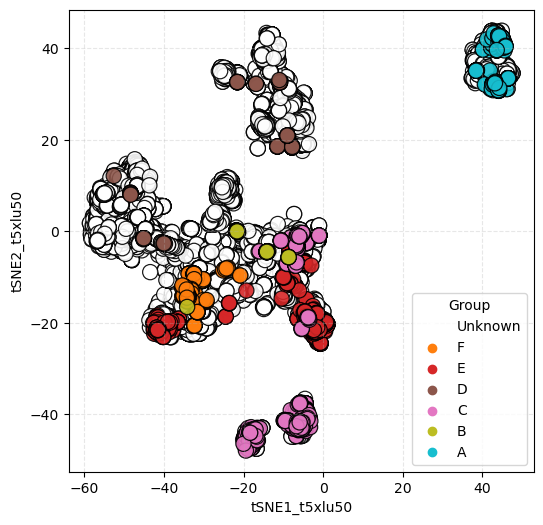

In [39]:
# load tsne coords and merge annots
df_sbl_t5xl = pd.read_csv("../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_sbl_t5xlu50.csv")
df_sbl_t5xl = df_sbl_t5xl.merge(df_annot, on = "seq_id")
df_a_t5xl = df_sbl_t5xl[df_sbl_t5xl.bla_class == "Class A"]

#filter by len 
df_a_t5xl = df_a_t5xl[df_a_t5xl['length'].between(209.3, 388.7)]
print(f"{len(df_a_t5xl)}")

def do_iscatter_t5(df, annot):
    
    """
    do a scatterplot given a df and hue
    """
    custom_palette = px.colors.qualitative.G10
    custom_palette[6] = "#FFFFFF"

    
    # plot
    fig = px.scatter(
    df, x = 'tSNE1_t5xlu50', y = 'tSNE2_t5xlu50',
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence = custom_palette,
    hover_data = ["protein_family_header", '#name'])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
    white_marker_style = {'marker': {'opacity': 0.02}}
    for i, color in enumerate(custom_palette):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    # fig.update_layout(plot_bgcolor='black')
    
    fig.show()

filters = [
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_a)),
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_b)),
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_c)),
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_d)),
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_e)),
    df_a_t5xl.protein_family_header.str.contains("|".join(cluster_f)),
]

values = ["A","B", "C", "D", "E", "F"]

#    "Group C (LSBL; limited-spectrum beta-lactamases)",
#    "Group D (Gram positive)",
#    "Group E (WSBL; wider spectrum betalactamases)",
#    "Group F (Gram negative rods)",
#    "Group A (Subclass A2)"
   
df_a_t5xl["Group"] = np.select(filters, values)

df_a_t5xl["Group"] = df_a_t5xl.Group.str.replace("0","Unknown")
df_a_t5xl = df_a_t5xl.sort_values("Group")

# do_iscatter_t5(df_a_t5xl, "Group")
plt.figure(figsize=(6,6))
sns.scatterplot(data = df_a_t5xl.sort_values("Group", ascending = False), x = "tSNE1_t5xlu50",y = "tSNE2_t5xlu50", 
                palette = custom_palette, s=120, hue = "Group", edgecolor = "black", alpha = 0.9)
plt.grid(alpha=0.3, linestyle="--")

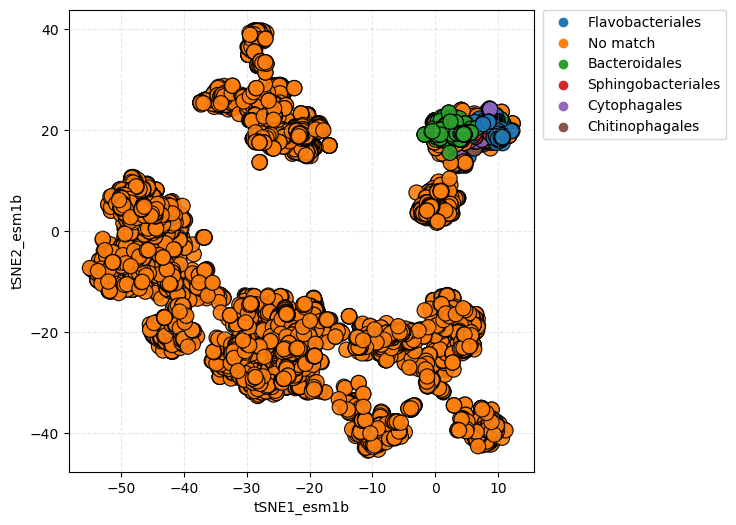

In [40]:
df_order = df_a.copy()
df_order = df_order.fillna("Other")

filters = [
    df_order.Order.str.contains("Bacteroidales"),
    df_order.Order.str.contains("Chitinophagales"),
    df_order.Order.str.contains("Cytophagales"),
    df_order.Order.str.contains("Flavobacteriales"),
    df_order.Order.str.contains("Sphingobacteriales"),
    df_order.Order.str.contains("Nostocales"),
    df_order.Order.str.contains("Spirochaetales")
]

values = [
    "Bacteroidales", "Chitinophagales", "Cytophagales", "Flavobacteriales", "Sphingobacteriales", 
    "Nostocales","Spirochaetales"
]

df_order["A2_orders"] = np.select(filters, values)
df_order["A2_orders"] = df_order.A2_orders.str.replace("0","No match")

def do_iscatter_order(df, annot):
    
    """
    do a scatterplot given a df and hue
    """
    order_color = px.colors.qualitative.G10
    order_color[1] = "#FFFFFF"

    
    # plot
    fig = px.scatter(
    df, x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence = order_color,
    hover_data = ["protein_family_header", '#name'])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
    white_marker_style = {'marker': {'opacity': 0.02}}
    for i, color in enumerate(order_color):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    # fig.update_layout(plot_bgcolor='black')
    
    fig.show() 


# do_iscatter_order(df_order, "A2_orders")

plt.figure(figsize=(6,6))
sns.scatterplot(data = df_order, x = "tSNE1_esm1b",y = "tSNE2_esm1b", 
                 s=120, hue = "A2_orders", edgecolor = "black", alpha = 0.9)
plt.grid(alpha=0.3, linestyle="--")
plt.legend(ncol=1, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


<AxesSubplot:xlabel='count', ylabel='A2_orders'>

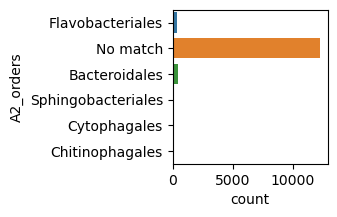

In [41]:
plt.figure(figsize=(2,2))
sns.countplot(data=df_order, y="A2_orders")

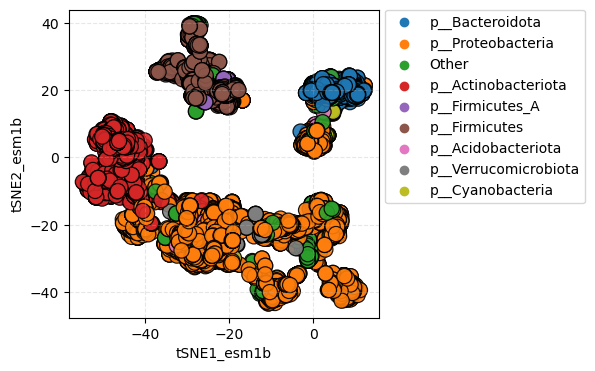

In [42]:
# taxonomic levels to plot
taxa_lst = ['Phylum', 'Class', 'Order', 'Family', 'Genus', 'Species']

# take the top10 mos abundant taxonomic levels
for taxa in taxa_lst:
    top9 = list(df_order[taxa].value_counts()[:9].index)
    df_order.loc[~df_order[taxa].isin(top9), taxa] = "Other"
    
def do_iscatter_tax(df, annot):
    
    """
    do a scatterplot given a df and hue
    """

    my_colors = px.colors.qualitative.Plotly_r
    my_colors[2] = "#FFFFFF"
    
    # plot
    fig = px.scatter(
    df, x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 500, color = annot,
    hover_name = annot, opacity=1, color_discrete_sequence = my_colors,
    hover_data = ["protein_family_header", '#name', "protein_name"])

    fig.update_traces(marker=dict(size=10, line=dict(width=1,color="black")),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
    white_marker_style = {'marker': {'opacity': 0.5}}
    for i, color in enumerate(my_colors):
        if color == "#FFFFFF":
            fig.update_traces(white_marker_style, selector=dict(marker_color=color))
    
    # fig.update_layout(plot_bgcolor='black')
    
    fig.show()

# do_iscatter_tax(df_order, "Phylum")

plt.figure(figsize=(4,4))
sns.scatterplot(data = df_order, x = "tSNE1_esm1b",y = "tSNE2_esm1b", 
                 s=120, hue = "Phylum", edgecolor = "black", alpha = 0.9)
plt.grid(alpha=0.3, linestyle="--")
plt.legend(ncol=1, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

## extendend

In [43]:
ls ../data/philippon

genus_a.txt*  genus_d.txt*  species_a.txt*  species_d.txt*
genus_b.txt*  genus_e.txt*  species_b.txt*  species_e.txt*
genus_c.txt*  genus_f.txt*  species_c.txt*  species_f.txt*


In [44]:
# load spp 
with open('../data/philippon/species_a.txt', 'r') as f:
    species = f.readlines()
group_a_spp = []
for spp in species:
    group_a_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/species_b.txt', 'r') as f:
    species = f.readlines()
group_b_spp = []
for spp in species:
    group_b_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/species_c.txt', 'r') as f:
    species = f.readlines()
group_c_spp = []
for spp in species:
    group_c_spp.append(spp.rstrip())
  
    
# load spp 
with open('../data/philippon/species_d.txt', 'r') as f:
    species = f.readlines()
group_d_spp = []
for spp in species:
    group_d_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/species_e.txt', 'r') as f:
    species = f.readlines()
group_e_spp = []
for spp in species:
    group_e_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/species_f.txt', 'r') as f:
    species = f.readlines()
group_f_spp = []
for spp in species:
    group_f_spp.append(spp.rstrip())
    df_a_phil = df_a.copy()

df_a_phil.fillna('other', inplace=True)

filters = [
    df_a_phil.Species.str.contains("|".join(group_a_spp)),
    df_a_phil.Species.str.contains("|".join(group_b_spp)),
    df_a_phil.Species.str.contains("|".join(group_c_spp)),
    df_a_phil.Species.str.contains("|".join(group_d_spp)),
    df_a_phil.Species.str.contains("|".join(group_e_spp)),
    df_a_phil.Species.str.contains("|".join(group_f_spp))
]

values = ["A","B", "C", "D", "E", "F"]
   
df_a_phil["Philippon"] = np.select(filters, values)

df_a_phil["Philippon"] = df_a_phil.Philippon.str.replace("0","Unknown")
df_a_phil = df_a_phil.sort_values("Philippon")

In [45]:
my_colors_spp = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
my_colors_spp[0] = "#FFFFFF"

fig = px.scatter(
    df_a_phil.sort_values("Philippon", ascending=False), x = 'tSNE1_esm1b', y = 'tSNE2_esm1b',
    height = 450, width = 550, color = "Philippon",
    hover_name = "Philippon", opacity=1, color_discrete_sequence = my_colors_spp,
    hover_data = ["protein_family_header", '#name', "protein_name"])

fig.update_traces(marker=dict(size=12, line=dict(width=2,color="black")),selector=dict(mode='markers'))
fig.update_layout(template="plotly_white")
fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    
white_marker_style = {'marker': {'opacity': 0.005}}
for i, color in enumerate(my_colors_spp):
    if color == "#FFFFFF":
        fig.update_traces(white_marker_style, selector=dict(marker_color=color))
fig.show()

<AxesSubplot:xlabel='Group', ylabel='length'>

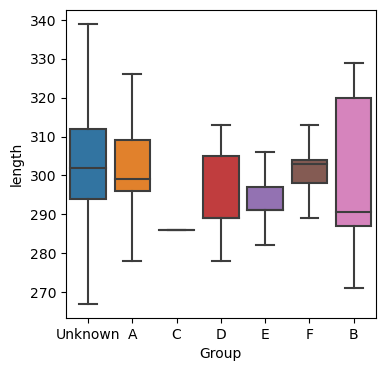

In [46]:
plt.figure(figsize=(4,4))
sns.boxplot(data=df_a_phil, x="Group", y="length",showfliers=False)

In [47]:
print(f"Group A has {len(set(group_a_spp))} species")
print(f"Group B has {len(set(group_b_spp))} species")
print(f"Group C has {len(set(group_c_spp))} species")
print(f"Group D has {len(set(group_d_spp))} species")
print(f"Group E has {len(set(group_e_spp))} species")
print(f"Group F has {len(set(group_f_spp))} species")

Group A has 106 species
Group B has 32 species
Group C has 90 species
Group D has 116 species
Group E has 55 species
Group F has 163 species


In [48]:
# load spp 
with open('../data/philippon/genus_a.txt', 'r') as f:
    species = f.readlines()
group_a_spp = []
for spp in species:
    group_a_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/genus_b.txt', 'r') as f:
    species = f.readlines()
group_b_spp = []
for spp in species:
    group_b_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/genus_c.txt', 'r') as f:
    species = f.readlines()
group_c_spp = []
for spp in species:
    group_c_spp.append(spp.rstrip())
  
    
# load spp 
with open('../data/philippon/genus_d.txt', 'r') as f:
    species = f.readlines()
group_d_spp = []
for spp in species:
    group_d_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/genus_e.txt', 'r') as f:
    species = f.readlines()
group_e_spp = []
for spp in species:
    group_e_spp.append(spp.rstrip())
    
    
# load spp 
with open('../data/philippon/genus_f.txt', 'r') as f:
    species = f.readlines()
group_f_spp = []
for spp in species:
    group_f_spp.append(spp.rstrip())
    df_a_phil = df_a.copy()

df_a_phil.fillna('other', inplace=True)

filters = [
    df_a_phil.Species.str.contains("|".join(group_a_spp)),
    df_a_phil.Species.str.contains("|".join(group_b_spp)),
    df_a_phil.Species.str.contains("|".join(group_c_spp)),
    df_a_phil.Species.str.contains("|".join(group_d_spp)),
    df_a_phil.Species.str.contains("|".join(group_e_spp)),
    df_a_phil.Species.str.contains("|".join(group_f_spp))
]

values = ["A","B", "C", "D", "E", "F"]
   
df_a_phil["Philippon"] = np.select(filters, values)

df_a_phil["Philippon"] = df_a_phil.Philippon.str.replace("0","Unknown")
df_a_phil = df_a_phil.sort_values("Philippon")

do_iscatter(df_a_phil.sort_values("Philippon", ascending=False), "Philippon")

<AxesSubplot:xlabel='Group', ylabel='length'>

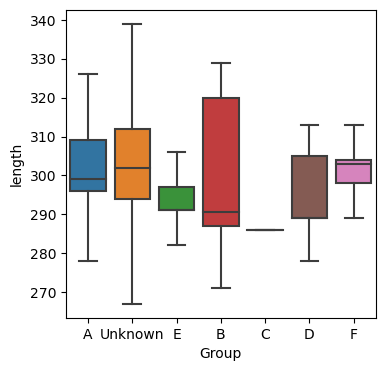

In [49]:
plt.figure(figsize=(4,4))
sns.boxplot(data=df_a_phil, x="Group", y="length",showfliers=False)

In [50]:
print(f"Group A has {len(set(group_a_spp))} genus")
print(f"Group B has {len(set(group_b_spp))} genus")
print(f"Group C has {len(set(group_c_spp))} genus")
print(f"Group D has {len(set(group_d_spp))} genus")
print(f"Group E has {len(set(group_e_spp))} genus")
print(f"Group F has {len(set(group_f_spp))} genus")

Group A has 61 genus
Group B has 20 genus
Group C has 47 genus
Group D has 54 genus
Group E has 25 genus
Group F has 78 genus


In [51]:
counts = Counter(group_a_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group A: \n {top5} \n")

counts = Counter(group_b_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group B: \n {top5} \n")

counts = Counter(group_c_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group C: \n {top5} \n")

counts = Counter(group_d_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group D: \n {top5} \n")
counts = Counter(group_e_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group E: \n {top5} \n")

counts = Counter(group_f_spp)
top5 = counts.most_common(5)
print(f"Top 3 genus in group F: \n {top5} \n")

Top 3 genus in group A: 
 [('Bacteroides', 14), ('Chryseobacterium', 10), ('Prevotella', 7), ('Alistipes', 3), ('Flavobacterium', 3)] 

Top 3 genus in group B: 
 [('Bradyrhizobium', 5), ('Sphingopyxis', 4), ('Altererythrobacter', 2), ('Gluconobacter', 2), ('Porphyrobacter', 2)] 

Top 3 genus in group C: 
 [('Vibrio', 16), ('Photobacterium', 9), ('Labrenzia', 5), ('Nitratireductor', 4), ('Marinobacter', 3)] 

Top 3 genus in group D: 
 [('Mycolicibacterium', 17), ('Bacillus', 9), ('Streptomyces', 9), ('Mycobacterium', 8), ('Clostridium', 5)] 

Top 3 genus in group E: 
 [('Burkholderia', 9), ('Legionella', 9), ('Yersinia', 6), ('Pantoea', 3), ('Chromobacterium', 3)] 

Top 3 genus in group F: 
 [('Bradyrhizobium', 13), ('Xanthomonas', 12), ('Rhizobium', 11), ('Stenotrophomonas', 8), ('Methylobacterium', 8)] 



fin